# DreamBooth Hackathon 🏆

Welcome to the DreamBooth Hackathon! In this competition, you'll **personalise a Stable Diffusion model by fine-tuning it on a handful of your own images.** To do so, we'll use a technique called [_DreamBooth_](https://arxiv.org/abs/2208.12242), which allows one to implant a subject (e.g. your pet or favourite dish) into the output domain of the model such that it can be synthesized with a _unique identifier_ in the prompt.

Let's dive in!

## Prerequisites

Before diving into this notebook, you should read the:

* [Unit 3 README](https://github.com/huggingface/diffusion-models-class/blob/main/unit3/README.md) that contains a deep dive into Stable Diffusion
* DreamBooth [blog post](https://dreambooth.github.io/) to get a sense of what's possible with this technique
* Hugging Face [blog post](https://huggingface.co/blog/dreambooth) on best practices for fine-tuning Stable Diffusion with DreamBooth

🚨 **Note:** the code in **this notebook requires at least 14GB of GPU vRAM** and is a simplified version of the [official training script](https://github.com/huggingface/diffusers/tree/main/examples/dreambooth) provided in 🤗 Diffusers. It produces decent models for most applications, but we recommend experimenting with the advanced features like class preservation loss & fine-tuning the text encoder if you have at least 24GB vRAM available. Check out the 🤗 Diffusers [docs](https://huggingface.co/docs/diffusers/training/dreambooth) for more details.

## What is DreamBooth?

DreamBooth is a technique to teach new concepts to Stable Diffusion using a specialized form of fine-tuning. If you're on Twitter or Reddit, you may have seen people using this technique to create (often hilarious) avatars of themselves. For example, here's what [Andrej Karpathy](https://karpathy.ai/) would look like as a cowboy (you may need to run the cell to see the output):

In [ ]:
%%html
<blockquote class="twitter-tweet"><p lang="en" dir="ltr">Stableboost auto-suggests a few hundred prompts by default but you can generate additional variations for any one prompt that seems to be giving fun/interesting results, or adjust it in any way: <a href="https://t.co/qWmadiXftP">pic.twitter.com/qWmadiXftP</a></p>&mdash; Andrej Karpathy (@karpathy) <a href="https://twitter.com/karpathy/status/1600578187141840896?ref_src=twsrc%5Etfw">December 7, 2022</a></blockquote> <script async src="https://platform.twitter.com/widgets.js" charset="utf-8"></script>

The way DreamBooth works is as follows:

* Collect around 10-20 input images of a subject (e.g., your dog) and define a unique identifier [V] that refers to the subject. This identifier is usually some made up word like `flffydog` which is implanted in different text prompts at inference time to place the subject in different contexts.
* Fine-tune the diffusion model by providing the images together with a text prompt like "A photo of a [V] dog" that contains the unique identifier and class name (i.e., "dog" in this example).
* (Optionally) Apply a special _class-specific prior preservation loss_, which leverages the semantic prior that the model has on the class and encourages it to generate diverse instances belong to the subject's class by injecting the class name in the text prompt. In practice, this step is only really needed for human faces and can be skipped for the themes we'll be exploring in this hackathon.

An overview of the DreamBooth technique is shown in the image below:

![](https://dreambooth.github.io/DreamBooth_files/high_level.png)

### What can DreamBooth do?

Besides putting your subject in interesting locations, DreamBooth can be used for _**text-guided view synthesis**_, where the subject is viewed from different viewpoints as shown in the example below:

![](https://dreambooth.github.io/DreamBooth_files/novel_views.png)

DreamBooth can also be used to modify properties of the subject, such as colour or mixing up animal species!

![](https://dreambooth.github.io/DreamBooth_files/property_modification.png)

Now that we've seen some of the cool things DreamBooth can do, let's start training our own models!

## Step 1: Setup

If you're running this notebook on Google Colab or Kaggle, run the cell below to install the required libraries:

In [ ]:
%pip install -qqU fsspec==2025.3.2 diffusers transformers bitsandbytes accelerate ftfy datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.9/72.9 MB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 367.1/367.1 kB 33.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 124.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 93.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 62.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

If you're running on Kaggle, you'll need to install the latest PyTorch version to work with 🤗 Accelerate:

In [ ]:
# Uncomment and run if using Kaggle's notebooks. You may need to restart the notebook afterwards
# %pip install -U torch torchvision torchaudio --extra-index-url https://download.pytorch.org/whl/cu116

To be able to push your model to the Hub and make it appear on the [DreamBooth Leaderboard](https://huggingface.co/spaces/dreambooth-hackathon/leaderboard), there are a few more steps to follow. First you have to create an [access token](https://huggingface.co/docs/hub/security-tokens) with _**write access**_ from your Hugging Face account and then execute the following cell and input your token:

In [ ]:
from huggingface_hub import notebook_login

notebook_login()

The final step is to install Git LFS:

In [ ]:
%%capture
!sudo apt -qq install git-lfs
!git config --global credential.helper store

## Step 2: Pick a theme

This competition is composed of 5 _themes_, where each theme will collect models belong to the following categories:

* **Animal 🐨:** Use this theme to generate images of your pet or favourite animal hanging out in the Acropolis, swimming, or flying in space.
* **Science 🔬:** Use this theme to generate cool synthetic images of galaxies, proteins, or any domain of the natural and medical sciences.
* **Food 🍔:** Use this theme to tune Stable Diffusion on your favourite dish or cuisine.
* **Landscape 🏔:** Use this theme to generate beautiful landscapes of your faourite mountain, lake, or garden.
* **Wildcard 🔥:** Use this theme to go wild and create Stable Diffusion models for any category of your choosing!

We'll be **giving out prizes to the top 3 most liked models per theme**, and you're encouraged to submit as many models as you want! Run the cell below to create a dropdown widget where you can select the theme you wish to submit to:

## Step 3: Create an image dataset and upload it to the Hub

Once you've picked a theme, the next step is to **create a dataset of images for that theme** and upload it to the Hugging Face Hub:

* You'll need around **10-20 images of the subject** that you wish to implant in the model. These can be photos you've taken or downloaded from platforms like [Unsplash](https://unsplash.com/). Alternatively, you can take a look at any of the [image datasets](https://huggingface.co/datasets?task_categories=task_categories:image-classification&sort=downloads) on the Hugging Face Hub for inspiration.
* For best results, we recommend using images of your subject from **different angles and perspectives**.

Once you've collected your images in a folder, you can upload them to the Hub by using the UI to drag and drop your images. See [this guide](https://huggingface.co/docs/datasets/upload_dataset#upload-with-the-hub-ui) for more details, or watch the video below:

Alternatively, you can load your dataset locally using the `imagefolder` feature of 🤗 Datasets and then push it to the Hub:

```python
from datasets import load_dataset

dataset = load_dataset("imagefolder", data_dir="your_folder_of_images")
# Push to Hub
dataset.push_to_hub("dreambooth-hackathon-images")
dataset = dataset['train']
```

Once you've created your dataset, you can download it by using the `load_dataset()` function as follows:

Now that we have our dataset, let's define a helper function to view a few of the images:

In [ ]:
from PIL import Image


def image_grid(imgs, rows, cols):
    assert len(imgs) == rows * cols
    w, h = imgs[0].size
    grid = Image.new("RGB", size=(cols * w, rows * h))
    grid_w, grid_h = grid.size
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i % cols * w, i // cols * h))
    return grid




If this looks good, you can move onto the next step - creating a PyTorch dataset for training with DreamBooth.

## Step 3: Create a training dataset

To create a training set for our images we need a few components:

* An _instance prompt_ that is used to prime the model at the start of training. In most cases, using "a photo of [identifier] [class noun]" works quite well, e.g., "a photo of ccorgi dog" for our cute Corgi pictures.
    * **Note:** it is recommended that you pick a unique / made up word like `ccorgi` to describe your subject. This will ensure a common word in the model's vocabulary isn't overwritten.
* A _tokenizer_ to convert the instance prompt into input IDs that can be fed to the text encoder of Stable Diffusion.
* A set of _image transforms_, notably resizing the images to a common shape and normalizing the pixel values to a common mean and standard distribution.

With this in mind, let's start by defining the instance prompt:

In [ ]:

import os
# Define the path to your images folder
#folder = ["/content/gond_image","/content/kerla_image","/content/warli_image"]
folder=["/content/kerla_image"]
# Create a list to store the image file paths
image_files = []

# Iterate through the files in the images folder
for images_folder in folder:

  for filename in os.listdir(images_folder):
      # Construct the full file path
      filepath = os.path.join(images_folder, filename)
      # Check if the file is an image (you might want to add more checks for specific image extensions)
      if os.path.isfile(filepath) and filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp','.webp')):
          image_files.append(filepath)



In [ ]:

#csvs = ["/content/gond_captions.csv","/content/kerala_mural.csv","/content/warli_captions.csv"]
#folder = ["/content/gond_image/","/content/kerla_image/","/content/warli_image/"]
csvs=["/content/kerala_mural.csv"]

di={}
i=0
k=0
for filename in csvs:
  with open(filename, 'r') as f:
      for line in f:
          if i==0:
            i+=1
            continue
          parts = line.strip().split(',', 1) # Split only at the first comma
          if len(parts) == 2:
              image_name = parts[0].strip()
              caption = parts[1].strip()

              #print(f"Image Name: {folder[k]+image_name}, Caption: {caption}")
              di[folder[k]+"/"+image_name]=caption
          elif len(parts) == 1:
              print(f"Line with only image name: {parts[0].strip()}")
          else:
              # print(f"Skipping line with unexpected format: {line.strip()}")
              print(f"Skipping line with unexpected format: {line.strip()}")
  k+=1


In [ ]:
# Define the local path to your images folder
local_data_dir = "/content/kerla_image"
from PIL import Image


data_dict = {"image": [], "text": []}

for img_path in image_files:
  try:
      img = Image.open(img_path).convert("RGB") # Ensure images are in RGB format
      data_dict["image"].append(img)
      data_dict["text"].append(di[img_path])
      #data_dict["text"].append("a painting in style of sks Gond")
  except:
    data_dict["image"].pop()
    print(img_path)


from datasets import Dataset

# Create a Hugging Face Dataset from the dictionary
dataset = Dataset.from_dict(data_dict)

print(dataset)


/content/kerla_image/kerala9.webp
/content/kerla_image/kerala86.webp
Dataset({
    features: ['image', 'text'],
    num_rows: 68
})


In [ ]:
# prompt: save the above dataset on hugging face on my account

#dataset.push_to_hub("himanshu0510/kerala_warli_gond_datset")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Map:   0%|          | 0/231 [00:00<?, ? examples/s]

Pushing dataset shards to the dataset hub:   0%|          | 0/1 [00:00<?, ?it/s]

Creating parquet from Arrow format:   0%|          | 0/3 [00:00<?, ?ba/s]

Uploading...:   0%|          | 0.00/424M [00:00<?, ?B/s]

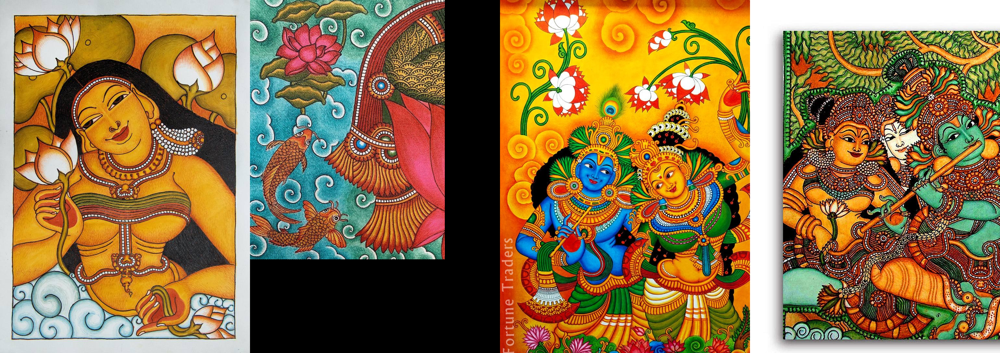

In [ ]:
from PIL import Image


def image_grid(imgs, rows, cols):
    assert len(imgs) == rows * cols
    w, h = imgs[0].size
    grid = Image.new("RGB", size=(cols * w, rows * h))
    grid_w, grid_h = grid.size
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i % cols * w, i // cols * h))
    return grid


num_samples = 4
image_grid(dataset["image"][:num_samples], rows=1, cols=num_samples)

Next, we need to create a PyTorch `Dataset` object that implements the `__len__` and `__getitem__` dunder methods:

In [ ]:
from torch.utils.data import Dataset
from torchvision import transforms


class DreamBoothDataset(Dataset):
    def __init__(self, dataset, tokenizer, size=512):
        self.dataset = dataset
        self.tokenizer = tokenizer
        self.size = size
        self.transforms = transforms.Compose(
            [
                transforms.Resize(size),
                transforms.CenterCrop(size),
                transforms.ToTensor(),
                transforms.Normalize([0.5], [0.5]),
            ]
        )

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, index):
        example = {}
        image = self.dataset[index]["image"]
        example["instance_images"] = self.transforms(image)
        prompt = f"A painting in sks gond : {self.dataset[index]['text']}"
        example["instance_prompt"] =prompt
        example["instance_prompt_ids"] = self.tokenizer(
            prompt,
            padding="do_not_pad",
            truncation=True,
            max_length=self.tokenizer.model_max_length,
        ).input_ids
        return example

In [ ]:
# # prompt: split dataset in train and test contains 20% in test and 80% in test

# #train_test_split = dataset.train_test_split(test_size=0.2)
# train_dataset = train_test_split['train']
# test_dataset = train_test_split['test']
# train_val=train_test_split['train']
# print("Train dataset:", train_dataset)
# print("Test dataset:", test_dataset)


Great, let's now check this works by loading the CLIP tokenizer associated with the text encoder of the original Stable Diffusion model, and then creating the training dataset:

In [ ]:
from transformers import CLIPTokenizer

# The Stable Diffusion checkpoint we'll fine-tune
model_id = "sd-legacy/stable-diffusion-v1-5"
#model_id="/content/my-dreambooth"
tokenizer = CLIPTokenizer.from_pretrained(
    model_id,
    subfolder="tokenizer",
)

train_dataset = DreamBoothDataset(dataset, tokenizer)
train_dataset[0]

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

{'instance_images': tensor([[[0.6000, 0.6078, 0.6157,  ..., 0.7255, 0.7333, 0.7333],
          [0.6000, 0.6078, 0.6157,  ..., 0.7333, 0.7412, 0.7412],
          [0.6000, 0.6078, 0.6157,  ..., 0.7333, 0.7412, 0.7412],
          ...,
          [0.6863, 0.6941, 0.6941,  ..., 0.7412, 0.7333, 0.7255],
          [0.6863, 0.6941, 0.6941,  ..., 0.7412, 0.7412, 0.7412],
          [0.7098, 0.7098, 0.7098,  ..., 0.7333, 0.7333, 0.7255]],
 
         [[0.6314, 0.6392, 0.6471,  ..., 0.7569, 0.7647, 0.7569],
          [0.6314, 0.6392, 0.6471,  ..., 0.7569, 0.7647, 0.7647],
          [0.6314, 0.6392, 0.6471,  ..., 0.7569, 0.7647, 0.7647],
          ...,
          [0.7176, 0.7255, 0.7255,  ..., 0.7725, 0.7647, 0.7569],
          [0.7176, 0.7255, 0.7255,  ..., 0.7725, 0.7725, 0.7725],
          [0.7412, 0.7412, 0.7412,  ..., 0.7647, 0.7647, 0.7569]],
 
         [[0.6392, 0.6471, 0.6549,  ..., 0.7961, 0.7961, 0.7961],
          [0.6392, 0.6471, 0.6549,  ..., 0.7961, 0.8039, 0.8039],
          [0.6392, 0.

## Step 4: Define a data collator

Now that we have a training dataset, the next thing we need is to define a _data collator_. A data collator is a function that collects elements in a batch of data and applies some logic to form a single tensor we can provide to the model. If you'd to learn more, you can check out this video from the [Hugging Face Course](hf.co/course):

For DreamBooth, our data collator need to provide the model with the input IDs from the tokenizer and the pixel values from the images as a stacked tensor. The function below does the trick:

In [ ]:
import torch


def collate_fn(examples):
    input_ids = [example["instance_prompt_ids"] for example in examples]
    pixel_values = [example["instance_images"] for example in examples]
    pixel_values = torch.stack(pixel_values)
    pixel_values = pixel_values.to(memory_format=torch.contiguous_format).float()

    input_ids = tokenizer.pad(
        {"input_ids": input_ids}, padding=True, return_tensors="pt"
    ).input_ids

    batch = {
        "input_ids": input_ids,
        "pixel_values": pixel_values,
    }
    return batch

## Step 5: Load the components of the Stable Diffusion pipeline

We nearly have all the pieces ready for training! As you saw in the Unit 3 notebook on Stable Diffusion, the pipeline is composed of several models:

* A text encoder that converts the prompts into text embeddings. Here we're using CLIP since it's the encoder used to train Stable Diffusion v1-4.
* A VAE or variational autoencoder that converts the images to compressed representations (i.e., latents) and decompresses them at inference time.
* A UNet that applies the denoising operation on the latent of the VAE.

We can load all these components using the 🤗 Diffusers and 🤗 Transformers libraries as follows:

In [ ]:
from diffusers import AutoencoderKL, UNet2DConditionModel
from transformers import CLIPFeatureExtractor, CLIPTextModel

text_encoder = CLIPTextModel.from_pretrained(model_id, subfolder="text_encoder")
vae = AutoencoderKL.from_pretrained(model_id, subfolder="vae")
unet = UNet2DConditionModel.from_pretrained(model_id, subfolder="unet")
feature_extractor = CLIPFeatureExtractor.from_pretrained("openai/clip-vit-base-patch32")

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

/usr/local/lib/python3.11/dist-packages/transformers/models/clip/feature_extraction_clip.py:30: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


## Step 6: Fine-tune the model

Now comes the fun part - training our model with DreamBooth! As shown in the [Hugging Face's blog post](https://huggingface.co/blog/dreambooth), the most essential hyperparameters to tweak are the learning rate and number of training steps.

In general, you'll get better results with a lower learning rate at the expense of needing to increase the number of training steps. The values below are a good starting point, but you may need to adjust them according to your dataset:

In [ ]:
learning_rate = 2e-06
max_train_steps =2000

Next, let's wrap the other hyperparameters we need in a `Namespace` object to make it easier to configure the training run:

In [ ]:
from argparse import Namespace

args = Namespace(
    pretrained_model_name_or_path=model_id,
    resolution=512, # Reduce this if you want to save some memory
    train_dataset=train_dataset,
    learning_rate=learning_rate,
    max_train_steps=max_train_steps,
    train_batch_size=1,
    gradient_accumulation_steps=1, # Increase this if you want to lower memory usage
    max_grad_norm=1.0,
    gradient_checkpointing=True,  # Set this to True to lower the memory usage
    use_8bit_adam=True,  # Use 8bit optimizer from bitsandbytes
    seed=3434554,
    sample_batch_size=2,
    output_dir="my-dreambooth",  # Where to save the pipeline
)

In [ ]:
!pip install torch torchvision --quiet

In [ ]:
from torchvision import transforms
from torchvision.models import vgg16
# === Loss helpers: perceptual and style losses ===
class VGGPerceptualLoss(torch.nn.Module):
    def __init__(self, device):
        super().__init__()
        vgg = vgg16(pretrained=True).features[:16].to(device)
        for param in vgg.parameters():
            param.requires_grad = False
        self.vgg = vgg

    def forward(self, x, y):
        # x, y expected normalized images [B,3,H,W] in [-1,1]
        # VGG expects [0,1], so rescale:
        x = (x + 1) / 2
        y = (y + 1) / 2
        fx = self.vgg(x)
        fy = self.vgg(y)
        return F.l1_loss(fx, fy)


def gram_matrix(x):
    b, c, h, w = x.size()
    features = x.view(b, c, h * w)
    G = torch.bmm(features, features.transpose(1, 2))
    return G / (c * h * w)


class StyleLoss(torch.nn.Module):
    def __init__(self, device):
        super().__init__()
        self.vgg = vgg16(pretrained=True).features[:16].to(device)
        for param in self.vgg.parameters():
            param.requires_grad = False

    def forward(self, x, y):
        x = (x + 1) / 2
        y = (y + 1) / 2
        loss = 0.0
        layers = [1, 6, 11]
        for layer in layers:
            fx = self.vgg[:layer](x)
            fy = self.vgg[:layer](y)
            loss += F.mse_loss(gram_matrix(fx), gram_matrix(fy))
        return loss




In [ ]:
import math

import torch.nn.functional as F
from accelerate import Accelerator
from accelerate.utils import set_seed
from diffusers import DDPMScheduler, PNDMScheduler, StableDiffusionPipeline
from diffusers.pipelines.stable_diffusion import StableDiffusionSafetyChecker
from torch.utils.data import DataLoader
from tqdm.auto import tqdm


def training_function(text_encoder, vae, unet):

    accelerator = Accelerator(
        gradient_accumulation_steps=args.gradient_accumulation_steps,
    )

    set_seed(args.seed)

    if args.gradient_checkpointing:
        unet.enable_gradient_checkpointing()

    # Use 8-bit Adam for lower memory usage or to fine-tune the model in 16GB GPUs
    if args.use_8bit_adam:
        import bitsandbytes as bnb
        optimizer_class = bnb.optim.AdamW8bit
    else:
        optimizer_class = torch.optim.AdamW

    optimizer = optimizer_class(
        unet.parameters(),  # Only optimize unet
        lr=args.learning_rate,
    )

    noise_scheduler = DDPMScheduler(
        beta_start=0.00085,
        beta_end=0.012,
        beta_schedule="scaled_linear",
        num_train_timesteps=1000,
    )

    train_dataloader = DataLoader(
        args.train_dataset,
        batch_size=args.train_batch_size,
        shuffle=True,
        collate_fn=collate_fn,
    )

    unet, optimizer, train_dataloader = accelerator.prepare(
        unet, optimizer, train_dataloader
    )

    # Move text_encode and vae to gpu
    text_encoder.to(accelerator.device)
    vae.to(accelerator.device)
    perceptual_loss_model = VGGPerceptualLoss(accelerator.device)
    style_loss_model = StyleLoss(accelerator.device)
    # We need to recalculate our total training steps as the size of the training dataloader may have changed
    num_update_steps_per_epoch = math.ceil(
        len(train_dataloader) / args.gradient_accumulation_steps
    )
    num_train_epochs = math.ceil(args.max_train_steps / num_update_steps_per_epoch)

    # Train!
    total_batch_size = (
        args.train_batch_size
        * accelerator.num_processes
        * args.gradient_accumulation_steps
    )
    # Only show the progress bar once on each machine
    progress_bar = tqdm(
        range(args.max_train_steps), disable=not accelerator.is_local_main_process
    )
    progress_bar.set_description("Steps")
    global_step = 0

    for epoch in range(num_train_epochs):
        unet.train()
        for step, batch in enumerate(train_dataloader):
            with accelerator.accumulate(unet):
                # Convert images to latent space
                with torch.no_grad():
                    latents = vae.encode(batch["pixel_values"]).latent_dist.sample()
                    latents = latents * 0.18215

                # Sample noise that we'll add to the latents
                noise = torch.randn(latents.shape).to(latents.device)
                bsz = latents.shape[0]
                # Sample a random timestep for each image
                timesteps = torch.randint(
                    0,
                    noise_scheduler.config.num_train_timesteps,
                    (bsz,),
                    device=latents.device,
                ).long()

                # Add noise to the latents according to the noise magnitude at each timestep
                # (this is the forward diffusion process)
                noisy_latents = noise_scheduler.add_noise(latents, noise, timesteps)

                # Get the text embedding for conditioning
                with torch.no_grad():
                    encoder_hidden_states = text_encoder(batch["input_ids"])[0]

                # Predict the noise residual
                noise_pred = unet(
                    noisy_latents, timesteps, encoder_hidden_states
                ).sample
                loss_mse = (
                    F.mse_loss(noise_pred, noise, reduction="none")
                    .mean([1, 2, 3])
                    .mean()
                )
                with torch.no_grad():
                    decoded_original = vae.decode(latents / 0.18215).sample

                # Calculate the denoised latents based on noise_pred and noisy_latents
                # This is a simplified way to get a "denoised" version at the current timestep
                # It's not the full reverse diffusion step, but serves for comparison
                # A more accurate approach would involve the scheduler's step function, but that's more complex within this training loop structure
                denoised_latents = noise_scheduler.step(noise_pred, timesteps, noisy_latents).pred_original_sample


                decoded_denoised = vae.decode(denoised_latents / 0.18215).sample

                loss_perc = perceptual_loss_model(decoded_denoised, decoded_original)
                loss_style = style_loss_model(decoded_denoised, decoded_original)

                # Total loss with weights (adjust if needed)
                loss = loss_mse +  0.01*loss_perc +  10*loss_style

                accelerator.backward(loss)
                if accelerator.sync_gradients:
                    accelerator.clip_grad_norm_(unet.parameters(), args.max_grad_norm)
                optimizer.step()
                optimizer.zero_grad()

            # Checks if the accelerator has performed an optimization step behind the scenes
            if accelerator.sync_gradients:
                progress_bar.update(1)
                global_step += 1

            logs = {"loss": loss.detach().item(),
                    "mse_loss":loss_mse.detach().item(),
                    "perc_loss":loss_perc.detach().item(),
                    "style_loss":loss_style.detach().item(),
                    }
            progress_bar.set_postfix(**logs)

            if global_step >= args.max_train_steps:
                break

        accelerator.wait_for_everyone()

    # Create the pipeline using the trained modules and save it
    if accelerator.is_main_process:
        print(f"Loading pipeline and saving to {args.output_dir}...")
        scheduler = PNDMScheduler(
            beta_start=0.00085,
            beta_end=0.012,
            beta_schedule="scaled_linear",
            skip_prk_steps=True,
            steps_offset=1,
        )
        pipeline = StableDiffusionPipeline(
            text_encoder=text_encoder,
            vae=vae,
            unet=accelerator.unwrap_model(unet),
            tokenizer=tokenizer,
            scheduler=scheduler,
            safety_checker=StableDiffusionSafetyChecker.from_pretrained(
                "CompVis/stable-diffusion-safety-checker"
            ),
            feature_extractor=feature_extractor,
        )
        pipeline.save_pretrained(args.output_dir)

In [ ]:
from accelerate import notebook_launcher

num_of_gpus = 1  # CHANGE THIS TO MATCH THE NUMBER OF GPUS YOU HAVE
notebook_launcher(
    training_function, args=(text_encoder, vae, unet), num_processes=num_of_gpus
)

Launching training on one GPU.


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:05<00:00, 101MB/s]


  0%|          | 0/2000 [00:00<?, ?it/s]

Loading pipeline and saving to my-dreambooth...


config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

In [ ]:
pipe = StableDiffusionPipeline.from_pretrained(
    args.output_dir,
    torch_dtype=torch.float16,
).to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/transformers/models/clip/feature_extraction_clip.py:30: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

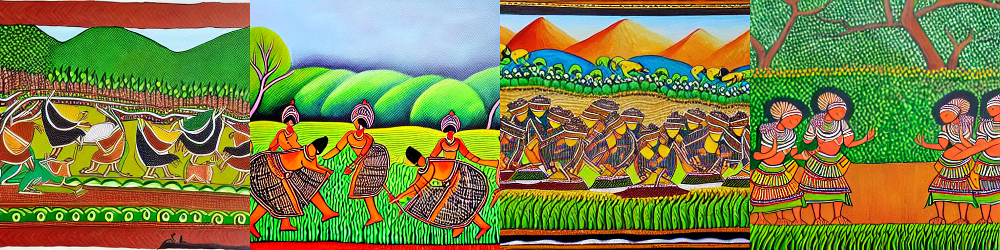

In [ ]:


prompt = f" A painting of sks gond : Tribal villagers harvesting rice in a lush green paddy field, depicted in traditional style."

# Tune the guidance to control how closely the generations follow the prompt
# Values between 7-11 usually work best
guidance_scale = 11

num_cols = 4
all_images = []
for _ in range(num_cols):
    images = pipe(prompt, guidance_scale=guidance_scale).images
    all_images.extend(images)

image_grid(all_images, 1, num_cols)

In [ ]:
# prompt: save my finetuned model to huggingface

repo_id = f"gond_style_loss-art-fine-tuned" # CHANGE THIS to a name of your choice
pipe.push_to_hub(repo_id)


Uploading...:   0%|          | 0.00/2.74G [00:00<?, ?B/s]

CommitInfo(commit_url='https://huggingface.co/himanshu0510/gond_style_loss-art-fine-tuned/commit/9142ff1795a7bd43908a291af8657cff1221a529', commit_message='Upload StableDiffusionPipeline', commit_description='', oid='9142ff1795a7bd43908a291af8657cff1221a529', pr_url=None, repo_url=RepoUrl('https://huggingface.co/himanshu0510/gond_style_loss-art-fine-tuned', endpoint='https://huggingface.co', repo_type='model', repo_id='himanshu0510/gond_style_loss-art-fine-tuned'), pr_revision=None, pr_num=None)

The final step is to define a `training_function()` function that wraps the training logic and can be passed to 🤗 Accelerate to handle training on 1 or more GPUs. If this is the first time you're using 🤗 Accelerate, check out this video to get a quick overview of what it can do:

In [ ]:
!pip install pytorch_msssim
!pip install evaluate
!pip install bert_score
!pip install rouge_score


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.1/84.1 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.1/61.1 kB 3.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for rouge_score: filename=rouge_score-0.1.2-py3-none-any.whl size=24934 sha256=64c99b9ffc5b14edcd249fc85927e7fd8a01fdd526528f7b2c879b973bed5d56
  Stored in directory: /root/.cache/pip/wheels/1e/19/43/8a442dc83660ca25e163e1bd1f89919284ab0d0c1475475148
Successfully built rouge_score


In [ ]:

from pytorch_msssim import ssim, ms_ssim
def ssim_loss(noise_pred, noise):

    loss = 1.0 - ssim(noise_pred, noise, data_range=2.0)
    return loss

The details should look familiar to what we saw in Units 1 & 2 when we trained our own diffusion models from scratch:

Now that we have the function defined, let's train it! Depending on the size of your dataset and type of GPU, this can take anywhere from 5 minutes to 1 hour to run:

Launching training on one GPU.


  0%|          | 0/2000 [00:00<?, ?it/s]

Loading pipeline and saving to my-dreambooth...


config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

If you're running on a single GPU, you can free up some memory for the next section by copying the code below into a new cell and running it. For multi-GPU machines, 🤗 Accelerate doesn't allow _any_ cell to directly access the GPU with `torch.cuda`, so we don't recommend using this trick in those cases:

```python
with torch.no_grad():
    torch.cuda.empty_cache()
```

## Step 7: Run inference and inspect generations

Now that we've trained the model, let's generate some images with it to see how it fares! First we'll load the pipeline from the output directory we save the model to:

In [ ]:
pipe = StableDiffusionPipeline.from_pretrained(
    args.output_dir,
    torch_dtype=torch.float16,
).to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/transformers/models/clip/feature_extraction_clip.py:30: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


Next, let's generate a few images. The `prompt` variable will later be used to set the default on the Hugging Face Hub widget, so experiment a bit to find a good one. You might also want to try creating elaborate prompts with [CLIP Interrogator](https://huggingface.co/spaces/pharma/CLIP-Interrogator):

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

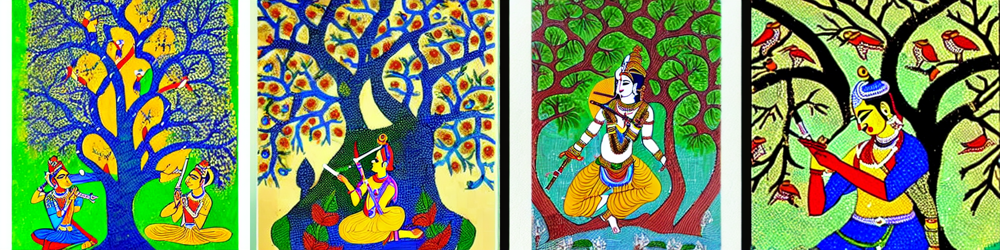

In [ ]:
# Pick a funny prompt here and it will be used as the widget's default
# when we push to the Hub in the next section
prompt = f" A painting of lord krishna playing flute under the tree in gond"

# Tune the guidance to control how closely the generations follow the prompt
# Values between 7-11 usually work best
guidance_scale = 11

num_cols = 4
all_images = []
for _ in range(num_cols):
    images = pipe(prompt, guidance_scale=guidance_scale).images
    all_images.extend(images)

image_grid(all_images, 1, num_cols)

In [ ]:
all_images = []
for i in range(len(test_dataset)):
  prompt=test_dataset[i]["text"]
  guidance_scale = 10

  num_cols = 1
  for _ in range(num_cols):
    images = pipe(prompt, guidance_scale=guidance_scale).images
    all_images.extend(images)


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
# prompt: dispaly all images along with caption that are in test_dataset
c_test=[]
for i, image in enumerate(all_images):
    print(f"Caption: {test_dataset[i]['text']}")
    c_test.append(test_dataset[i]['text'])
    display(image)

In [ ]:

from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
from transformers import CLIPProcessor, CLIPModel, OwlViTProcessor, OwlViTForObjectDetection, BlipProcessor, BlipForConditionalGeneration
import torch
import evaluate
import pandas as pd
import os
from tqdm import tqdm
from evaluate import load




In [ ]:
data_dict = {"image": all_images, "text": c_test}
from datasets import Dataset

# Create a Hugging Face Dataset from the dictionary
dataset = Dataset.from_dict(data_dict)

print(dataset)

Dataset({
    features: ['image', 'text'],
    num_rows: 47
})


In [ ]:
class TribalArtDataset(Dataset):
    def __init__(self, dataset,size=512):
        self.dataset = dataset
        self.size=size
        self.transform = transforms.Compose([
            transforms.Resize(size),
                transforms.CenterCrop(size),
                transforms.ToTensor(),
                transforms.Normalize([0.5], [0.5]),
        ])

    def __len__(self):
        return len(self.dataset)

    def __getitem__(self, index):
        example = {}
        image = self.dataset[index]["image"]
        example["instance_image"] = self.transform(image)
        example["instance_text"]=self.dataset[index]["text"]
        return example




In [ ]:

data = TribalArtDataset(dataset)

In [ ]:
# ✅ Load Models
clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")



blip_processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
blip_model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base")

In [ ]:
bleu = load("bleu")
rouge = load("rouge")
meteor = load("meteor")
bertscore = load("bertscore")

# Functions
def compute_bleu(pred, ref):
    return bleu.compute(predictions=[pred], references=[[ref]])["bleu"]

def compute_rouge(pred, ref):
    return rouge.compute(predictions=[pred], references=[ref])["rougeL"]

def compute_meteor(pred, ref):
    return meteor.compute(predictions=[pred], references=[ref])["meteor"]

def compute_bertscore(pred, ref):
    return bertscore.compute(predictions=[pred], references=[ref], lang="en")["f1"][0]

def compute_clipscore(img_pil, caption):
    inputs = clip_processor(text=[caption], images=img_pil, return_tensors="pt", padding=True, truncation=True, max_length=77)
    with torch.no_grad():
        outputs = clip_model(**inputs)
        similarity = torch.cosine_similarity(outputs.image_embeds, outputs.text_embeds)
    return similarity.item()


def generate_blip_caption(img_pil):
    inputs = blip_processor(images=img_pil, return_tensors="pt")
    with torch.no_grad():
        out = blip_model.generate(**inputs)
    return blip_processor.decode(out[0], skip_special_tokens=True)




[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


In [ ]:
results = []
clip_avg=0
blip_avg=0
bleu_avg=0
rouge_avg=0
meteor_avg=0
bertscore_avg=0
for i in range (len(data)):
    caption = data[i]["instance_text"]
    img=data[i]["instance_image"]
    img_pil = transforms.ToPILImage()(data[i]["instance_image"][0])
    clipscore = compute_clipscore(img_pil, caption)
    blip_caption = generate_blip_caption(img_pil)
    bleu_score=compute_bleu(blip_caption,caption)
    rouge_score=compute_rouge(blip_caption,caption)
    meteor_score=compute_meteor(blip_caption,caption)
    bertscore_score=compute_bertscore(blip_caption,caption)
    clip_avg+=clipscore
    blip_avg+=bleu_score
    bleu_avg+=bleu_score
    rouge_avg+=rouge_score
    meteor_avg+=meteor_score
    bertscore_avg+=bertscore_score

    results.append({
        "image_path": "image"+str(i),
        "caption": caption,
        "clip_score": clipscore,
        "blip_caption": blip_caption,
        "bleu_score": bleu_score,
        "rouge_score": rouge_score,
        "meteor_score": meteor_score,
        "bert_score":bertscore_score

    })
    if i%10==0:
      print(i)
clip_avg/=len(data)
blip_avg/=len(data)
bleu_avg/=len(data)
rouge_avg/=len(data)
meteor_avg/=len(data)
bertscore_avg/=len(data)

# ✅ Display Results
df_results = pd.DataFrame(results)
print("Average Clip Score", clip_avg)
print("Average Rouge Score", rouge_avg)
print("Average Meteor Score", meteor_avg)
print("Average Bert Score", bertscore_avg)

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


0
10
Average Clip Score 0.2906380179855559
Average Rouge Score 0.1331267628372945
Average Meteor Score 0.06335738098967886
Average Bert Score 0.8403195705678728


In [ ]:
!pip install lpips scikit-image clean-fid

In [ ]:
import os
import torch
import torchvision.transforms as T
from PIL import Image
from tqdm import tqdm
import lpips

from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
import numpy as np
from cleanfid import fid
transform = T.Compose([
    T.Resize((256, 256)),
    T.ToTensor()
])

def load_image_tensor(img):
    return transform(img).unsqueeze(0)  # shape: [1, 3, H, W]

def load_image_array(img):
    img_tensor = transform(img)
    return img_tensor.permute(1, 2, 0).numpy() # Permute from (C, H, W) to (H, W, C) and convert to numpy

lpips_model = lpips.LPIPS(net='alex')


results = []
lpips_avg=0
ssin_avg=0
psnr_avg=0
for i in range(len(all_images)):
    img1=all_images[i]
    img2=test_dataset[i]["image"]
    name=test_dataset[i]["text"]
    img1_t = load_image_tensor(img1)
    img2_t = load_image_tensor(img2)
    img1_np = load_image_array(img1)
    img2_np = load_image_array(img2)


    lp = lpips_model(img1_t, img2_t).item()
    lpips_avg+=lp
    #ds = dists_model(img1, img2).item()
    # Now the shape is (H, W, C), so multichannel=True will work correctly
    ssim_score = ssim(img1_np, img2_np, multichannel=True, channel_axis=-1, data_range=img1_np.max() - img1_np.min())
    ssin_avg+=ssim_score
    psnr_score = psnr(img1_np, img2_np, data_range=img1_np.max() - img1_np.min())
    psnr_avg+=psnr_score
    #print(f"LPIPS: {lp}, SSIM: {ssim_score}, PSNR: {psnr_score}")
    results.append({
        "image": name,
        "LPIPS": lp,
        #"DISTS": ds,
        "SSIM": ssim_score,
        "PSNR": psnr_score
    })

# ✅ Save results
print(f"LPIPS: {lpips_avg/len(all_images)}, SSIM: {ssin_avg/len(all_images)}, PSNR: {psnr_avg/len(all_images)}")
import pandas as pd
df = pd.DataFrame(results)
df.to_csv("image_similarity_metrics.csv", index=False)
df.head()


Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


/usr/local/lib/python3.11/dist-packages/skimage/metrics/_structural_similarity.py:269: RuntimeWarning: invalid value encountered in divide
  S = (A1 * A2) / D
/usr/local/lib/python3.11/dist-packages/skimage/metrics/simple_metrics.py:168: RuntimeWarning: divide by zero encountered in log10
  return 10 * np.log10((data_range**2) / err)


LPIPS: 0.7211290299892426, SSIM: nan, PSNR: -inf


,image,LPIPS,SSIM,PSNR
0,A harmonious depiction of wildlife in Gond art...,0.608562,0.182199,9.418289
1,"Bird perched on a branch, adorned with intrica...",0.794038,0.112978,5.254790
2,"Intricate Gond art depicting a large, mytholog...",0.671575,0.023837,7.317909
3,A vibrant depiction of a mythical bird in Gond...,0.727068,0.014758,7.731613
4,A vibrant depiction of stylized birds in Gond ...,0.654275,0.088660,7.558393


In [ ]:
all_images_train = []
for i in range(len(train_val)):
  prompt=train_val[i]["text"]
  guidance_scale = 11

  num_cols = 1
  for _ in range(num_cols):
    images = pipe(prompt, guidance_scale=guidance_scale).images
    all_images_train.extend(images)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (81 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['d _ art ]']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
# prompt: dispaly all images along with caption that are in test_dataset
c_train=[]
for i, image in enumerate(all_images_train):
    print(f"Caption: {train_val[i]['text']}")
    c_train.append(train_val[i]['text'])
    display(image)

In [ ]:
pips_model = lpips.LPIPS(net='alex')


results = []
lpips_avg=0
ssin_avg=0
psnr_avg=0
for i in range(len(all_images_train)):
    img1=all_images_train[i]
    img2=train_val[i]["image"]
    name=train_val[i]["text"]
    img1_t = load_image_tensor(img1)
    img2_t = load_image_tensor(img2)
    img1_np = load_image_array(img1)
    img2_np = load_image_array(img2)


    lp = lpips_model(img1_t, img2_t).item()
    lpips_avg+=lp
    #ds = dists_model(img1, img2).item()
    # Now the shape is (H, W, C), so multichannel=True will work correctly
    ssim_score = ssim(img1_np, img2_np, multichannel=True, channel_axis=-1, data_range=img1_np.max() - img1_np.min())
    ssin_avg+=ssim_score
    psnr_score = psnr(img1_np, img2_np, data_range=img1_np.max() - img1_np.min())
    psnr_avg+=psnr_score
    #print(f"LPIPS: {lp}, SSIM: {ssim_score}, PSNR: {psnr_score}")
    results.append({
        "image": name,
        "LPIPS": lp,
        #"DISTS": ds,
        "SSIM": ssim_score,
        "PSNR": psnr_score
    })

# ✅ Save results
print(f"LPIPS: {lpips_avg/len(all_images)}, SSIM: {ssin_avg/len(all_images)}, PSNR: {psnr_avg/len(all_images)}")

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth
LPIPS: 2.735618677404192, SSIM: 0.3024793267250061, PSNR: 26.969013395330737


In [ ]:
data_dict = {"image": all_images_train, "text": c_train}
from datasets import Dataset

# Create a Hugging Face Dataset from the dictionary
dataset = Dataset.from_dict(data_dict)

print(dataset)

data_train = TribalArtDataset(dataset)


Dataset({
    features: ['image', 'text'],
    num_rows: 71
})


In [ ]:
results_train = []
clip_avg=0
blip_avg=0
bleu_avg=0
rouge_avg=0
meteor_avg=0
bertscore_avg=0
for i in range (len(data_train)):
    caption = data_train[i]["instance_text"]
    img=data_train[i]["instance_image"]
    img_pil = transforms.ToPILImage()(data_train[i]["instance_image"][0])
    clipscore = compute_clipscore(img_pil, caption)
    blip_caption = generate_blip_caption(img_pil)
    bleu_score=compute_bleu(blip_caption,caption)
    rouge_score=compute_rouge(blip_caption,caption)
    meteor_score=compute_meteor(blip_caption,caption)
    bertscore_score=compute_bertscore(blip_caption,caption)
    clip_avg+=clipscore
    blip_avg+=bleu_score
    bleu_avg+=bleu_score
    rouge_avg+=rouge_score
    meteor_avg+=meteor_score
    bertscore_avg+=bertscore_score

    results_train.append({
        "image_path": "image"+str(i),
        "caption": caption,
        "clip_score": clipscore,
        "blip_caption": blip_caption,
        "bleu_score": bleu_score,
        "rouge_score": rouge_score,
        "meteor_score": meteor_score,
        "bert_score":bertscore_score

    })
    if i%10==0:
      print(i)
clip_avg/=len(data_train)
blip_avg/=len(data_train)
bleu_avg/=len(data_train)
rouge_avg/=len(data_train)
meteor_avg/=len(data_train)
bertscore_avg/=len(data_train)

# ✅ Display Results
df_results_train = pd.DataFrame(results_train)
print("Average Clip Score", clip_avg)
print("Average Rouge Score", rouge_avg)
print("Average Meteor Score", meteor_avg)
print("Average Bert Score", bertscore_avg)

0
10
20
30
40
50
60
70
Average Clip Score 0.29090784196282776
Average Rouge Score 0.13774705666700912
Average Meteor Score 0.0685142922566653
Average Bert Score 0.8461178918959389


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

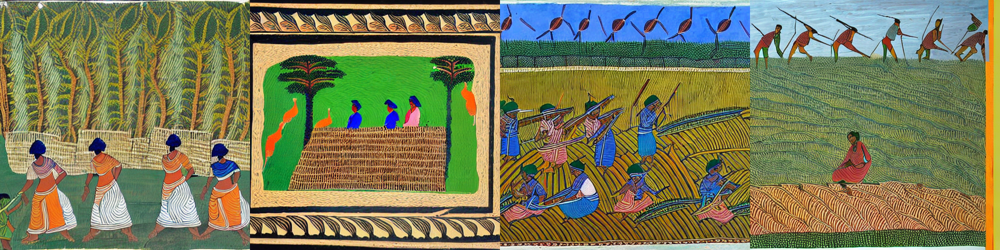

In [ ]:
# Pick a funny prompt here and it will be used as the widget's default
# when we push to the Hub in the next section
prompt = f" A painting of rice harvesting in sks gond."

# Tune the guidance to control how closely the generations follow the prompt
# Values between 7-11 usually work best
guidance_scale = 11

num_cols = 4
all_images = []
for _ in range(num_cols):
    images = pipe(prompt, guidance_scale=guidance_scale).images
    all_images.extend(images)

image_grid(all_images, 1, num_cols)

In [ ]:
# prompt: save my finetuned model to huggingface

repo_id = f"gondsks-art-fine-tuned" # CHANGE THIS to a name of your choice
pipe.push_to_hub(repo_id)


Uploading...:   0%|          | 0.00/2.74G [00:00<?, ?B/s]

CommitInfo(commit_url='https://huggingface.co/himanshu0510/gondsks-art-fine-tuned/commit/2d7c3adac190ac3c3da06e24db68ffa8134fd07d', commit_message='Upload StableDiffusionPipeline', commit_description='', oid='2d7c3adac190ac3c3da06e24db68ffa8134fd07d', pr_url=None, repo_url=RepoUrl('https://huggingface.co/himanshu0510/gondsks-art-fine-tuned', endpoint='https://huggingface.co', repo_type='model', repo_id='himanshu0510/gondsks-art-fine-tuned'), pr_revision=None, pr_num=None)

In [ ]:
# prompt: use this above repo id and then load it from hub to collab

from diffusers import StableDiffusionPipeline
import torch

repo_id = f"gondsks-art-fine-tuned"
pipe = StableDiffusionPipeline.from_pretrained(repo_id, torch_dtype=torch.float16).to("cuda")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Couldn't connect to the Hub: 404 Client Error. (Request ID: Root=1-686024f9-6a1dc2810abcfa900b091bdc;9ba7f181-f06f-41d2-92c5-476e4a5bb589)

Repository Not Found for url: https://huggingface.co/api/models/gond-art-fine-tuned.
Please make sure you specified the correct `repo_id` and `repo_type`.
If you are trying to access a private or gated repo, make sure you are authenticated. For more details, see https://huggingface.co/docs/huggingface_hub/authentication.
Will try to load fr

OSError: Cannot load model gond-art-fine-tuned: model is not cached locally and an error occurred while trying to fetch metadata from the Hub. Please check out the root cause in the stacktrace above.

['Gond tribal art featuring two stylized birds perched symmetrically on swirling green vines, encircling vibrant, patterned snails against a textured, earthy backdrop. Intricate line work and mythological motifs intertwine with bold folk colors of red, green, yellow, and blue, embodying the harmony of nature. in style of [Gond_art]',
 "A mythical blue bird gracefully intertwines with a lush green tree, surrounded by small, vibrant brown creatures, all depicted with intricate line work and bold folk colors, embodying Gond tribal art's connection to nature and mythology. in style of [Gond_art]",
 'A vibrant Gond artwork showcasing birds amidst the branches of a tree, adorned with intricate line work and mythological motifs. Rich, bold folk colors enhance the dynamic nature elements, embodying the essence of storytelling through traditional art. in style of [Gond_art]',
 'Two vividly colored birds rest beneath an intricately detailed tree, their feathers adorned with mythological motifs. 

In [ ]:

captions = data_dict["text"]

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd
def caption_matcher(captions,command):
  texts = captions + [command]
  vectorizer = TfidfVectorizer().fit(texts)
  vectors = vectorizer.transform(texts)
  scores = cosine_similarity(vectors[-1], vectors[:-1])[0]
  scores_with_indices = list(enumerate(scores))
  sorted_scores_with_indices = sorted(scores_with_indices, key=lambda item: item[1], reverse=True)

  # Print the sorted indices and scores
  print("Sorted indices and scores from max to min:")
  for index, score in sorted_scores_with_indices[:5]:
    print(f"Index: {index}, Score: {score:.4f}, Caption: {captions[index]}")

In [ ]:
captions = data_dict["text"]
caption_matcher(captions,"a tribal art painting of fish and people")

Sorted indices and scores from max to min:
Index: 29, Score: 0.2281, Caption: Vibrant depiction of mythological fish adorned with intricate line work and bold, earthy colors, capturing Gond art’s essence. Surrounding fish intertwine gracefully, embodying nature’s harmony. in style of [Gond_art]
Index: 32, Score: 0.2116, Caption: A vibrant Gond painting depicting a stylized peacock intertwined with a tree adorned with red blossoms. The artwork features intricate linework and mythological motifs, using bold folk colors of blue and red, reflecting nature's harmony and beauty in traditional Gond art style. in style of [Gond_art]
Index: 8, Score: 0.1834, Caption: Three mythical fish intertwined with vibrant foliage, depicted in intricate line work. The composition features bold folk colors and intricate patterns, embodying the essence of Gond tribal art. in style of [Gond_art]
Index: 44, Score: 0.1690, Caption: Intricate Gond art depicting a large, mythological fish adorned with vibrant sca

In [ ]:
scores_with_indices = list(enumerate(scores))
# Sort the list based on the scores in descending order
sorted_scores_with_indices = sorted(scores_with_indices, key=lambda item: item[1], reverse=True)

# Print the sorted indices and scores
print("Sorted indices and scores from max to min:")
for index, score in sorted_scores_with_indices[:5]:
  print(f"Index: {index}, Score: {score:.4f}")

Sorted indices and scores from max to min:
Index: 32, Score: 0.3922
Index: 73, Score: 0.2749
Index: 45, Score: 0.2218
Index: 74, Score: 0.1899
Index: 11, Score: 0.1780


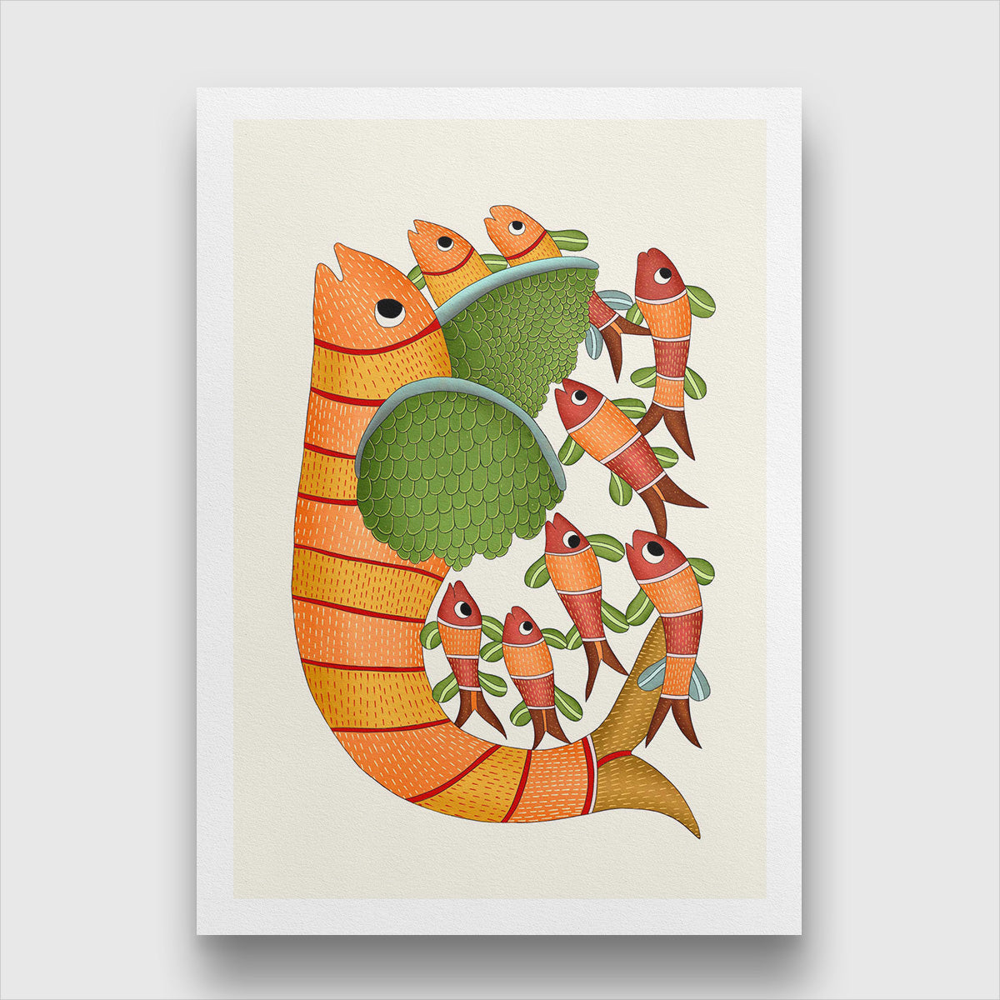

In [ ]:
data_dict['image'][29]

In [ ]:
data_dict['text'][29]

'Vibrant depiction of mythological fish adorned with intricate line work and bold, earthy colors, capturing Gond art’s essence. Surrounding fish intertwine gracefully, embodying nature’s harmony. in style of [Gond_art]'

## Step 8: Push your model to the Hub

If you're happy with you model, the final step is to push it to the Hub and view it on the [DreamBooth Leaderboard](https://huggingface.co/spaces/dreambooth-hackathon/leaderboard)!

First, you'll need to define a name for your model repo. By default, we use the unique identifier and class name, but feel free to change this if you want:

In [ ]:
# Create a name for your model on the Hub. No spaces allowed.
model_name = "diffusion-gondart-himanshu"

Next, add a brief description on the type of model you've trained or any other information you'd like to share:

In [ ]:
# Describe the theme and model you've trained
description = f"""
This is a Stable Diffusion model fine-tuned on `gond painting` images for the bhil art theme theme.
"""

Finally, run the cell below to create a repo on the Hub and push all our files with a nice model card to boot:

In [ ]:
# Code to upload a pipeline saved locally to the hub
from huggingface_hub import HfApi, ModelCard, create_repo, get_full_repo_name

# Set up repo and upload files
hub_model_id = get_full_repo_name(model_name)
create_repo(hub_model_id)
api = HfApi()
api.upload_folder(folder_path=args.output_dir, path_in_repo="", repo_id=hub_model_id)

content = f"""
---
license: creativeml-openrail-m
tags:
- pytorch
- diffusers
- stable-diffusion
- text-to-image
- diffusion-models-class
- dreambooth-hackathon
- {theme}
widget:
- text: {prompt}
---

# DreamBooth model for the {name_of_your_concept} concept trained by {api.whoami()["name"]} on the {dataset_id} dataset.

This is a Stable Diffusion model fine-tuned on the {name_of_your_concept} concept with DreamBooth. It can be used by modifying the `instance_prompt`: **{instance_prompt}**

This model was created as part of the DreamBooth Hackathon 🔥. Visit the [organisation page](https://huggingface.co/dreambooth-hackathon) for instructions on how to take part!

## Description

{description}

## Usage

```python
from diffusers import StableDiffusionPipeline

pipeline = StableDiffusionPipeline.from_pretrained('{hub_model_id}')
image = pipeline().images[0]
image
```
"""

card = ModelCard(content)
hub_url = card.push_to_hub(hub_model_id)
print(f"Upload successful! Model can be found here: {hub_url}")
print(
    f"View your submission on the public leaderboard here: https://huggingface.co/spaces/dreambooth-hackathon/leaderboard"
)

NameError: name 'model_name' is not defined

## Step 9: Celebrate 🥳

Congratulations, you've trained your very first DreamBooth model! You can train as many models as you want for the competition - the important thing is that **the most liked models will win prizes** so don't forget to share your creation far and wide to get the most votes!